# Storytelling_Airbnb, NYC Case Study

## <font color = Green > Problem Statement </font>

Suppose that you are working as a data analyst at Airbnb. For the past few months, Airbnb has seen a major decline in revenue. Now that the restrictions have started lifting and people have started to travel more, Airbnb wants to make sure that it is fully prepared for this change.

## <font color = Green > Business Goal </font>

The different leaders at Airbnb want to understand some important insights based on various attributes in the dataset so as to increase the revenue such as -

1. Which type of hosts to acquire more and where?
2. The categorisation of customers based on their preferences.
    - What are the neighbourhoods they need to target?
    - What is the pricing ranges preferred by customers?
    - The various kinds of properties that exist w.r.t. customer preferences.
    - Adjustments in the existing properties to make it more customer-oriented.
3. What are the most popular localities and properties in New York currently?
4. How to get unpopular properties more traction? and so on...

## <font color = Green > Objectives </font>

To prepare for the next best steps that Airbnb needs to take as a business, you have been asked to analyse a dataset consisting of various Airbnb listings in New York. Based on this analysis, you need to give two presentations to the following groups.

1. Presentation - I
+ **Data Analysis Managers:** These people manage the data analysts directly for processes and their technical expertise is basic.
+ **Lead Data Analyst:** The lead data analyst looks after the entire team of data and business analysts and is technically sound.

2. Presentation - II
+ **Head of Acquisitions and Operations, NYC:** This head looks after all the property and host acquisitions and operations. Acquisition of the best properties, price negotiation, and negotiating the services the properties offer falls under the purview of this role.
+ **Head of User Experience, NYC:** The head of user experience looks after the customer preferences and also handles the properties listed on the website and the Airbnb app. Basically, the head of user experience tries to optimise the order of property listing in certain neighbourhoods and cities in order to get every property the optimal amount of traction.

## <font color = Green > Recommend strategies to manage customer churn based on your observations. </font>

+ Although this is a storytelling exercise meaning that the tasks performed on the data are not important for the end objective, **there is a methodology document that you need to submit**. This document should ideally contain the entire methodology, technical details, and assumptions wherever applicable. This document is also necessary to verify all the steps you have performed to arrive at the final presentations and hence without it, your presentations will not be graded.
+ Once you are done with the analysis and visualisations, there will be many insights at your hand. Make sure that you map the right visuals and takeaways with the right audience since some of these insights might be relevant to one group but not to the other group

## <font color = Green > Steps Followed </font>

+ **Data Understanding, Preparation, and Pre-Processing :**
     - Data understanding, identification of potentially useful and non-useful attributes and variable importance and impact estimation
     - Data preparation, performing data cleaning, missing values imputation, outlier removal, and column level standardization (for e.g., date, etc.) into one format
     
+ **Feature Engineering and Variable Transformation :**
     - Feature engineering and performing one or more methods on attributes that can lead to the creation of a new potentially useful variable; for e.g., day from the date
     - Variable transformation and applying categorical variable transformations to turn into numerical data and numerical variable transformations to scale data
 
+ **Exploratory Data Analysis :**
     - Performing basic preliminary data analysis including finding the correlation between variables and scatter plots to identify relationships between variables
     - Performing advanced data analysis, including plotting relevant heatmaps, histograms, and basic clustering to find patterns in the data


# <font color = blue> Data Understanding, Preparation, and Pre-Processing </font>


In [2]:
# Importing Libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline
plt.style.use('seaborn-dark-palette')
from scipy import stats

import datetime as dt

import plotly
import plotly.express as px

In [3]:
import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [4]:
# load the dataset

airbnb = pd.read_csv("AB_NYC_2019.csv")
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0


In [5]:
# Dimensions

airbnb.shape

(48895, 16)

In [6]:
# Datatypes

airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

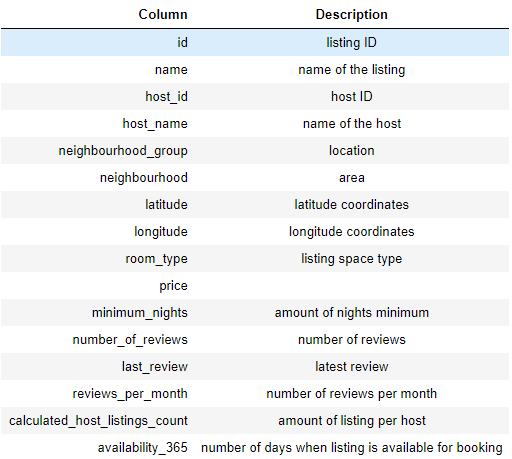

### <font color = Green > Insights: </font>

+ There are 3 floats, 7 integers and 6 objects data type values in the dataframe. 
+ There seems to be many columns with missing values. 
+ Need to check the reason behind the missing values and some feature engineering needed too.

In [7]:
# Numeric Analysis

airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


### <font color = Green > Insights: </font>

+ latttitude and longitude obviously belongs to the New York city as we have the data from the same. 
+ We can see prices starting from 0 dollar going upto 10 grand in dollars for hosting a place. Question why there is 0 dollar price for a hosted place on Airbnb and for which place? 
+ There seem to huge variance in minimum_nights, number_of_reviews, reviews_per_month and calculated_host_listings_count columns. Somethings needs to be checked in the detail too under these columns. 

In [7]:
# Duplicate check:

duplicate = airbnb.copy()
duplicate.drop_duplicates(subset = None, inplace = True)
duplicate.shape

(48895, 16)

In [8]:
# Converting id to object

airbnb['id'] = airbnb.id.astype(str)

In [9]:
# Converting host_id to object

airbnb['host_id'] = airbnb.host_id.astype(str)

In [10]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  object 
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  object 
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [11]:
# Analysing categorical values

airbnb.select_dtypes(include=['object']).describe()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,room_type,last_review
count,48895,48879,48895,48874,48895,48895,48895,38843
unique,48895,47896,37457,11452,5,221,3,1764
top,2539,Hillside Hotel,219517861,Michael,Manhattan,Williamsburg,Entire home/apt,23-06-2019
freq,1,18,327,417,21661,3920,25409,1413


### <font color = Green > Insights: </font>

+ Manhattan seems to be a most friendly neighbourhood group and Williamsburg the most know location underneath that. 
+ Hillside Hotel is the top hosted place which is the Entire home/apt room type. 
+ This place is hosted by Michael. 

In [12]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0


### Handling Missing Values

<AxesSubplot:>

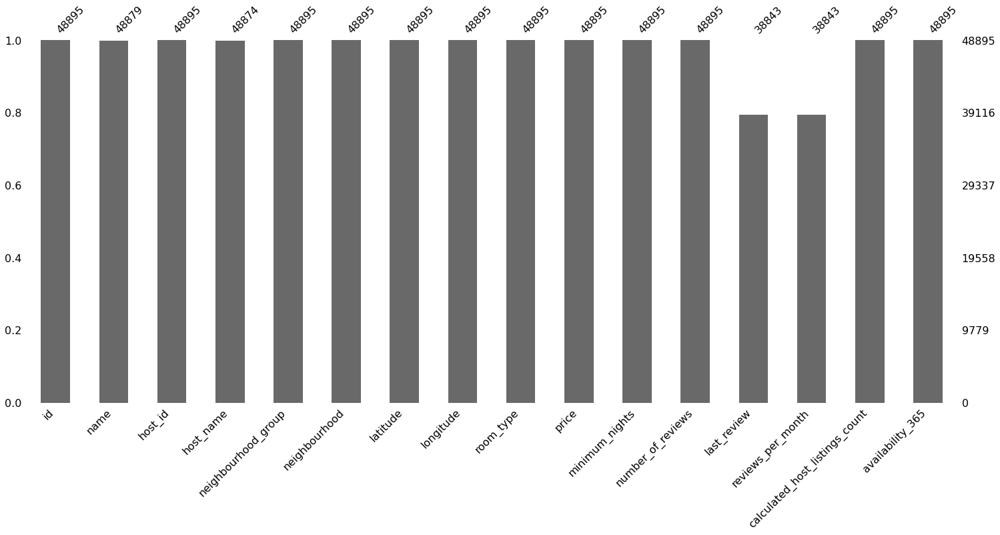

In [13]:
# Checking missing values columns

import missingno as msno
msno.bar(airbnb)

In [14]:
# Checking missing values percentages

def null_values(airbnb):
    return round((airbnb.isnull().sum()/len(airbnb)*100).sort_values(ascending = False),2)

null_values(airbnb)

last_review                       20.56
reviews_per_month                 20.56
host_name                          0.04
name                               0.03
id                                 0.00
host_id                            0.00
neighbourhood_group                0.00
neighbourhood                      0.00
latitude                           0.00
longitude                          0.00
room_type                          0.00
price                              0.00
minimum_nights                     0.00
number_of_reviews                  0.00
calculated_host_listings_count     0.00
availability_365                   0.00
dtype: float64

In [15]:
airbnb.head(10)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,22-06-2019,0.59,1,129
6,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68688,-73.95596,Private room,60,45,49,05-10-2017,0.40,1,0
7,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,24-06-2019,3.47,1,220
8,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.80178,-73.96723,Private room,79,2,118,21-07-2017,0.99,1,0
9,5238,Cute & Cozy Lower East Side 1 bdrm,7549,Ben,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,09-06-2019,1.33,4,188


In [16]:
airbnb[airbnb.number_of_reviews == 0]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
19,7750,Huge 2 BR Upper East Cental Park,17985,Sing,Manhattan,East Harlem,40.79685,-73.94872,Entire home/apt,190,7,0,NaN,NaN,2,249
26,8700,Magnifique Suite au N de Manhattan - vue Cloitres,26394,Claude & Sophie,Manhattan,Inwood,40.86754,-73.92639,Private room,80,4,0,NaN,NaN,1,0
36,11452,Clean and Quiet in Brooklyn,7355,Vt,Brooklyn,Bedford-Stuyvesant,40.68876,-73.94312,Private room,35,60,0,NaN,NaN,1,365
38,11943,Country space in the city,45445,Harriet,Brooklyn,Flatbush,40.63702,-73.96327,Private room,150,1,0,NaN,NaN,1,365
193,51438,1 Bedroom in 2 Bdrm Apt- Upper East,236421,Jessica,Manhattan,Upper East Side,40.77333,-73.95199,Private room,130,14,0,NaN,NaN,2,0
204,54466,Beautiful Uptown Manhattan apartmnt,253385,Douglas,Manhattan,Harlem,40.80234,-73.95603,Private room,200,30,0,NaN,NaN,1,365
260,63588,LL3,295128,Carol Gloria,Bronx,Clason Point,40.81309,-73.85514,Private room,90,2,0,NaN,NaN,7,349
265,63913,"HOSTING YOUR SUNNY, SPACIOUS NYC ROOM",312288,Paula,Manhattan,Inwood,40.86648,-73.92630,Private room,75,7,0,NaN,NaN,2,323
267,64015,Prime East Village 1 Bedroom,146944,David,Manhattan,East Village,40.72807,-73.98594,Entire home/apt,200,3,0,NaN,NaN,1,0


In [17]:
print(len(airbnb[airbnb.number_of_reviews == 0]))

10052


### <font color = Green > Insights: </font>

+ The values missing in last_review and reviews_per_month carrying NaN values is on purpose meaning they are not missing at random as these hosted sites/places have not receive any reviews from the customers. Hence, these placess would be least preferred by the future customers and would also be facing bad business from our side. 
+ There are in all 10052 unreviewed hosted sites on the account which is around 20% of all hosted sites. 

In [18]:
# Replacing the missing values of reviews_per_month with a zero 

airbnb["reviews_per_month"] = airbnb.reviews_per_month.fillna(0)

In [19]:
# Rechecking the null values
null_values(airbnb)

last_review                       20.56
host_name                          0.04
name                               0.03
id                                 0.00
host_id                            0.00
neighbourhood_group                0.00
neighbourhood                      0.00
latitude                           0.00
longitude                          0.00
room_type                          0.00
price                              0.00
minimum_nights                     0.00
number_of_reviews                  0.00
reviews_per_month                  0.00
calculated_host_listings_count     0.00
availability_365                   0.00
dtype: float64

In [20]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,0.00,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0


In [21]:
airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                     0
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [22]:
airbnb[airbnb.isnull().any(axis=1)]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,0.00,1,365
19,7750,Huge 2 BR Upper East Cental Park,17985,Sing,Manhattan,East Harlem,40.79685,-73.94872,Entire home/apt,190,7,0,NaN,0.00,2,249
26,8700,Magnifique Suite au N de Manhattan - vue Cloitres,26394,Claude & Sophie,Manhattan,Inwood,40.86754,-73.92639,Private room,80,4,0,NaN,0.00,1,0
36,11452,Clean and Quiet in Brooklyn,7355,Vt,Brooklyn,Bedford-Stuyvesant,40.68876,-73.94312,Private room,35,60,0,NaN,0.00,1,365
38,11943,Country space in the city,45445,Harriet,Brooklyn,Flatbush,40.63702,-73.96327,Private room,150,1,0,NaN,0.00,1,365
193,51438,1 Bedroom in 2 Bdrm Apt- Upper East,236421,Jessica,Manhattan,Upper East Side,40.77333,-73.95199,Private room,130,14,0,NaN,0.00,2,0
204,54466,Beautiful Uptown Manhattan apartmnt,253385,Douglas,Manhattan,Harlem,40.80234,-73.95603,Private room,200,30,0,NaN,0.00,1,365
260,63588,LL3,295128,Carol Gloria,Bronx,Clason Point,40.81309,-73.85514,Private room,90,2,0,NaN,0.00,7,349
265,63913,"HOSTING YOUR SUNNY, SPACIOUS NYC ROOM",312288,Paula,Manhattan,Inwood,40.86648,-73.92630,Private room,75,7,0,NaN,0.00,2,323
267,64015,Prime East Village 1 Bedroom,146944,David,Manhattan,East Village,40.72807,-73.98594,Entire home/apt,200,3,0,NaN,0.00,1,0


### <font color = Green > Insights: </font>

+ We have 16 places and 21 host names that are missing. 
+ Let's cross check them with the help of their id's to verify whether they are missing at random or by chance? 

In [23]:
airbnb[airbnb.id == '1615764']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
2854,1615764,NaN,6676776,Peter,Manhattan,Battery Park City,40.71239,-74.0162,Entire home/apt,400,1000,0,NaN,0.0,1,362


In [24]:
airbnb[airbnb.id == '2232600']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
3703,2232600,NaN,11395220,Anna,Manhattan,East Village,40.73215,-73.98821,Entire home/apt,200,1,28,08-06-2015,0.45,1,341


In [25]:
airbnb[airbnb.id == '4209595']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
5775,4209595,NaN,20700823,Jesse,Manhattan,Greenwich Village,40.73473,-73.99244,Entire home/apt,225,1,1,01-01-2015,0.02,1,0


In [26]:
airbnb[airbnb.host_id == '526653']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
360,100184,Bienvenue,526653,NaN,Queens,Queens Village,40.72413,-73.76133,Private room,50,1,43,08-07-2019,0.45,1,88


In [27]:
airbnb[airbnb.host_id == '7779204']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
2700,1449546,Cozy Studio in Flatbush,7779204,NaN,Brooklyn,Flatbush,40.64965,-73.96154,Entire home/apt,100,30,49,02-01-2017,0.69,1,342


In [28]:
airbnb[airbnb.host_id == '919218']

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
5745,4183989,SPRING in the City!! Zen-Style Tranquil Bedroom,919218,NaN,Manhattan,Harlem,40.80606,-73.95061,Private room,86,3,34,23-05-2019,1.0,1,359


### <font color = Green > Insights: </font>

+ Seems like these values (host name and their place name) are missing by chance hence we need to collect this information from the Host acquistion and operations team. 
+ For now we leave these rows as blank. 

In [29]:
# Rechecking the null values
null_values(airbnb)

last_review                       20.56
host_name                          0.04
name                               0.03
id                                 0.00
host_id                            0.00
neighbourhood_group                0.00
neighbourhood                      0.00
latitude                           0.00
longitude                          0.00
room_type                          0.00
price                              0.00
minimum_nights                     0.00
number_of_reviews                  0.00
reviews_per_month                  0.00
calculated_host_listings_count     0.00
availability_365                   0.00
dtype: float64

<AxesSubplot:>

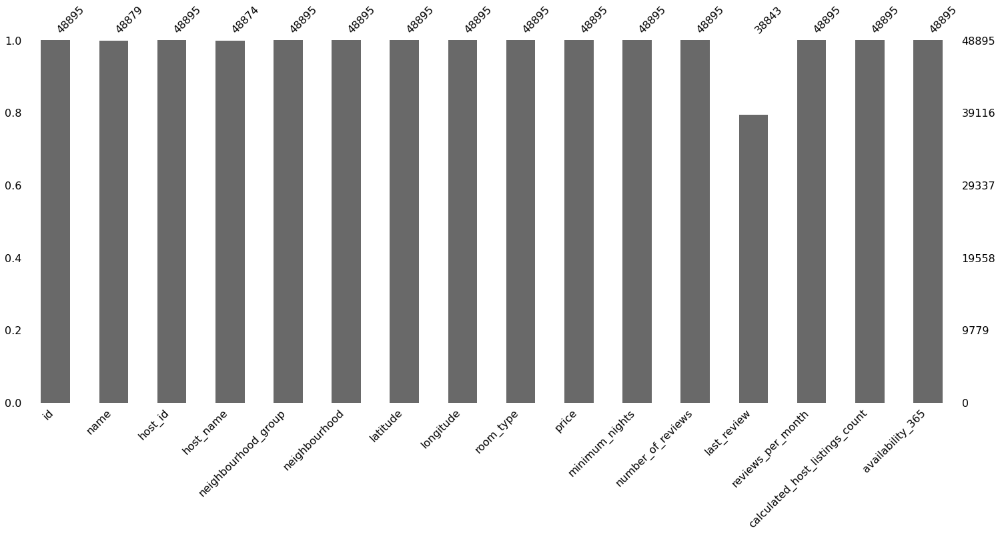

In [30]:
# Rechecking the missing values content
msno.bar(airbnb)

### <font color = Green > Insights: </font>

+ We will deal with the last_review column ahead. 


### <font color = Red >  Datafram is almost free from Missing Values  </font>


In [31]:
# Checking the variance again 

airbnb.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
latitude,48895.0,40.728949,0.054530,40.49979,40.69010,40.72307,40.763115,40.91306
longitude,48895.0,-73.952170,0.046157,-74.24442,-73.98307,-73.95568,-73.936275,-73.71299
price,48895.0,152.720687,240.154170,0.00000,69.00000,106.00000,175.000000,10000.00000
minimum_nights,48895.0,7.029962,20.510550,1.00000,1.00000,3.00000,5.000000,1250.00000
number_of_reviews,48895.0,23.274466,44.550582,0.00000,1.00000,5.00000,24.000000,629.00000
reviews_per_month,48895.0,1.090910,1.597283,0.00000,0.04000,0.37000,1.580000,58.50000
calculated_host_listings_count,48895.0,7.143982,32.952519,1.00000,1.00000,1.00000,2.000000,327.00000
availability_365,48895.0,112.781327,131.622289,0.00000,0.00000,45.00000,227.000000,365.00000


### <font color = Green > Insights: </font>

+ Need to deal with the outliers now. 

### Outliers Treatment


In [32]:
# Extracting Numeric columns: 

int_cols = airbnb.select_dtypes(include=['int64', 'float64']).columns

In [33]:
# Tagging them: 

list(enumerate(int_cols))

[(0, 'latitude'),
 (1, 'longitude'),
 (2, 'price'),
 (3, 'minimum_nights'),
 (4, 'number_of_reviews'),
 (5, 'reviews_per_month'),
 (6, 'calculated_host_listings_count'),
 (7, 'availability_365')]

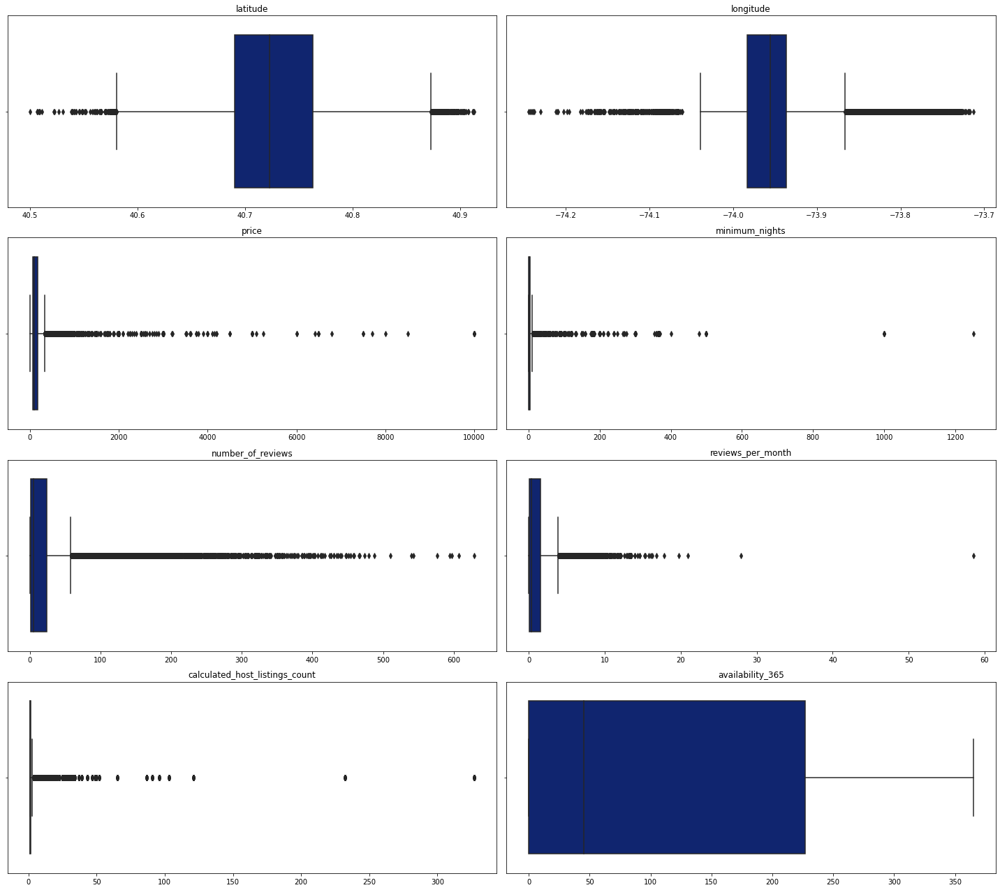

In [34]:
# Plotting the spread of outliers: 

plt.figure(figsize=([20,22]))

for n,col in enumerate(int_cols):
    plt.subplot(5,2,n+1)
    sns.boxplot(airbnb[col], orient = "h")
    plt.xlabel("")
    plt.ylabel("")
    plt.title(col)
    plt.tight_layout()

### <font color = Green > Insights: </font>


In [35]:
# Capping (statistical) outliers

# outlier treatment for price: 
Q1 = airbnb.price.quantile(0.10) 
Q3 = airbnb.price.quantile(0.90) 
IQR = Q3 - Q1  
airbnb = airbnb[(airbnb.price >= Q1 - 1.5*IQR) & (airbnb.price <= Q3 + 1.5*IQR)]

# outlier treatment for minimum_nights: 
Q1 = airbnb.minimum_nights.quantile(0.10) 
Q3 = airbnb.minimum_nights.quantile(0.90) 
IQR = Q3 - Q1  
airbnb = airbnb[(airbnb.minimum_nights >= Q1 - 1.5*IQR) & (airbnb.minimum_nights <= Q3 + 1.5*IQR)]

# outlier treatment for minimum_nights: 
Q1 = airbnb.number_of_reviews.quantile(0.10) 
Q3 = airbnb.number_of_reviews.quantile(0.90) 
IQR = Q3 - Q1  
airbnb = airbnb[(airbnb.number_of_reviews >= Q1 - 1.5*IQR) & (airbnb.number_of_reviews <= Q3 + 1.5*IQR)]

# outlier treatment for reviews_per_month: 
Q1 = airbnb.reviews_per_month.quantile(0.10) 
Q3 = airbnb.reviews_per_month.quantile(0.90) 
IQR = Q3 - Q1  
airbnb = airbnb[(airbnb.reviews_per_month >= Q1 - 1.5*IQR) & (airbnb.reviews_per_month <= Q3 + 1.5*IQR)]

# outlier treatment for calculated_host_listings_count: 
Q1 = airbnb.calculated_host_listings_count.quantile(0.10) 
Q3 = airbnb.calculated_host_listings_count.quantile(0.90) 
IQR = Q3 - Q1  
airbnb = airbnb[(airbnb.calculated_host_listings_count >= Q1 - 1.5*IQR) & 
                (airbnb.calculated_host_listings_count <= Q3 + 1.5*IQR)]

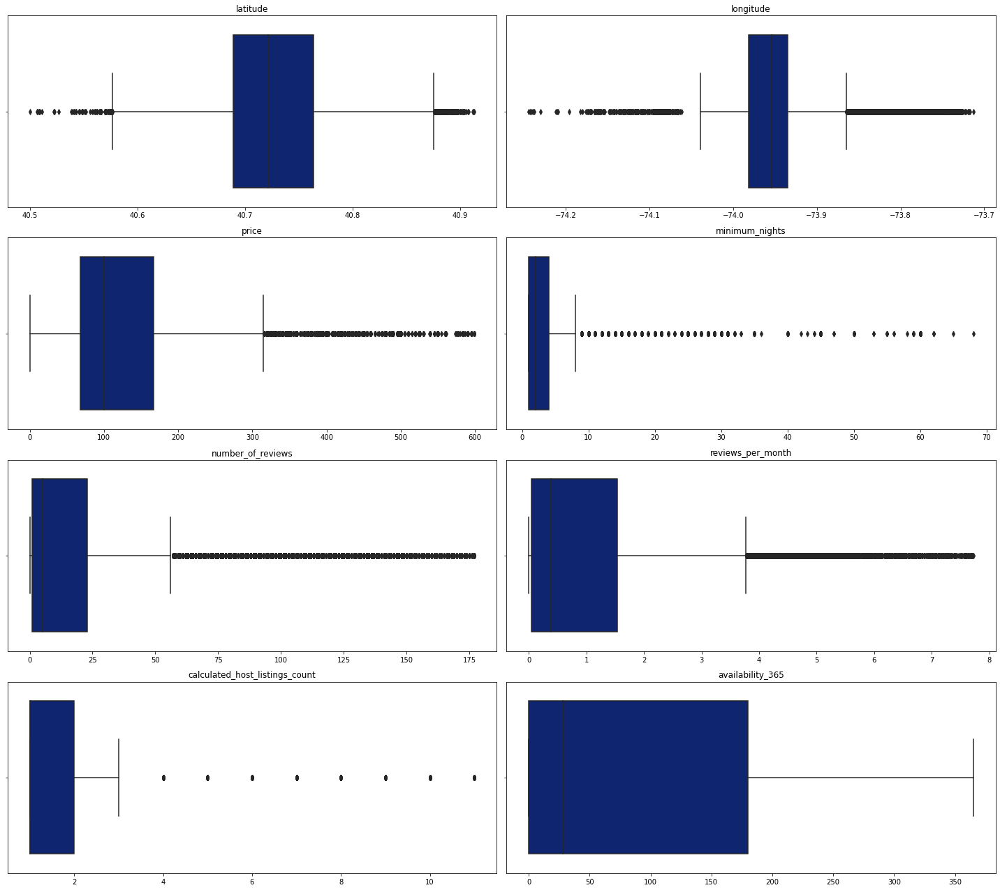

In [36]:
plt.figure(figsize=([20,22]))

for n,col in enumerate(int_cols):
    plt.subplot(5,2,n+1)
    sns.boxplot(airbnb[col], orient = "h")
    plt.xlabel("")
    plt.ylabel("")
    plt.title(col)
    plt.tight_layout()

In [37]:
airbnb.describe()

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,43912.000000,43912.000000,43912.000000,43912.000000,43912.000000,43912.000000,43912.000000,43912.000000
mean,40.728127,-73.950958,130.918496,4.941519,20.135248,1.035923,1.710444,99.108421
std,0.055684,0.046060,90.573400,7.605380,32.648184,1.398766,1.555874,125.394263
min,40.499790,-74.244420,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,40.688810,-73.981680,68.000000,1.000000,1.000000,0.050000,1.000000,0.000000
50%,40.721200,-73.954385,100.000000,2.000000,5.000000,0.390000,1.000000,28.000000
75%,40.763580,-73.934820,167.000000,4.000000,23.000000,1.540000,2.000000,180.000000
max,40.913060,-73.712990,599.000000,68.000000,177.000000,7.720000,11.000000,365.000000


### <font color = Green > Insights: </font>

+ Looks like we were able to manage the outliers, enough to analyse the information in EDA. 


# <font color = blue> Feature Engineering & Standardisation </font>


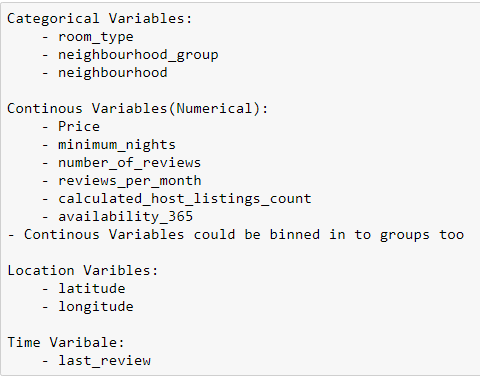

In [38]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,0.00,1,365
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,22-06-2019,0.59,1,129


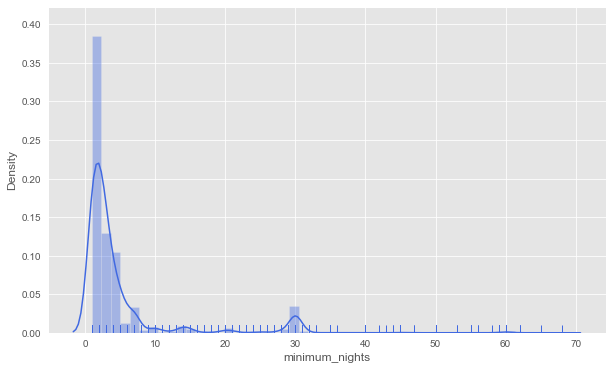

In [39]:
sns.set_style("dark")
plt.style.use("ggplot")
plt.figure(figsize=[10,6])
sns.distplot(airbnb['minimum_nights'], rug = True, color = 'royalblue')
plt.show()

In [40]:
# Creating minimum_nights into binned groups and storing it in another column. Keeping the numeric values too for analysis. 

airbnb["minimum_nights_range"] = pd.cut(airbnb.minimum_nights, 
                                  [0,10,20,30,40,50,60,70], 
                                  labels=["<10", "10 to 20", "20 to 30", "30 to 40", "40 to 50", "50 to 60", "60+"])
airbnb["minimum_nights_range"].value_counts()

<10         39759
20 to 30     2547
10 to 20     1249
30 to 40      194
50 to 60      112
40 to 50       46
60+             5
Name: minimum_nights_range, dtype: int64

In [41]:
# Converting minimum_nights_range to object datatype

airbnb['minimum_nights_range'] = airbnb.minimum_nights_range.astype(str)

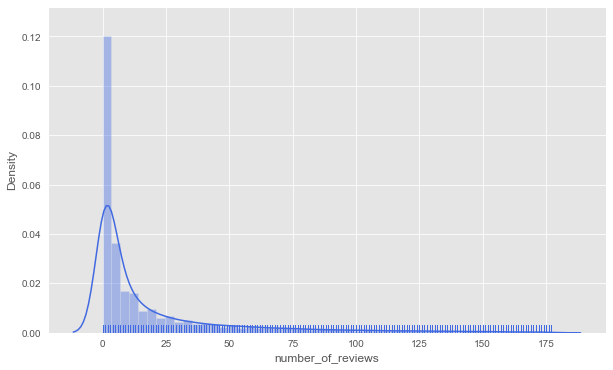

In [42]:
sns.set_style("dark")
plt.style.use("ggplot")
plt.figure(figsize=[10,6])
sns.distplot(airbnb['number_of_reviews'], rug = True, color = 'royalblue')
plt.show()

In [43]:
# Creating number_of_reviews into binned groups and storing it in another column. Keeping the numeric values too for analysis. 

airbnb["number_of_reviews_range"] = pd.cut(airbnb.number_of_reviews, 
                                                  [0,50,100,150,200], 
                                                  labels=["<50", "50 to 100", "100 to 150", "150+"])
airbnb["number_of_reviews_range"].value_counts()

<50           29634
50 to 100      3826
100 to 150     1595
150+            435
Name: number_of_reviews_range, dtype: int64

In [44]:
# Converting number_of_reviews_range to object datatype

airbnb['number_of_reviews_range'] = airbnb.number_of_reviews_range.astype(str)

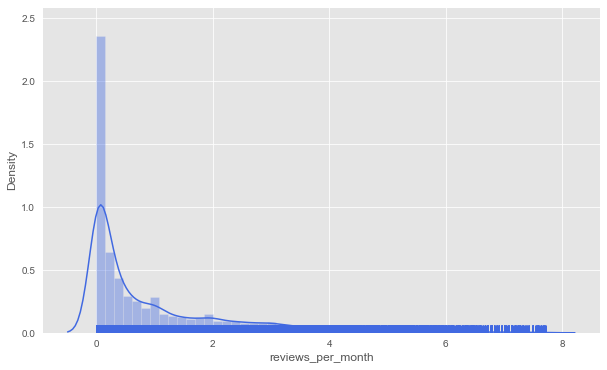

In [45]:
sns.set_style("dark")
plt.style.use("ggplot")
plt.figure(figsize=[10,6])
sns.distplot(airbnb['reviews_per_month'], rug = True, color = 'royalblue')
plt.show()

In [46]:
# Creating reviews_per_month into binned groups and storing it in another column. Keeping the numeric values too for analysis. 

airbnb["reviews_per_month_range"] = pd.cut(airbnb.reviews_per_month, 
                                                  [0,2,4,6,8],
                                                  labels=["<2", "2 to 4", "4 to 6", "6+"])
airbnb["reviews_per_month_range"].value_counts()

<2        27064
2 to 4     6120
4 to 6     1914
6+          392
Name: reviews_per_month_range, dtype: int64

In [47]:
# Converting reviews_per_month_range to object datatype

airbnb['reviews_per_month_range'] = airbnb.reviews_per_month_range.astype(str)

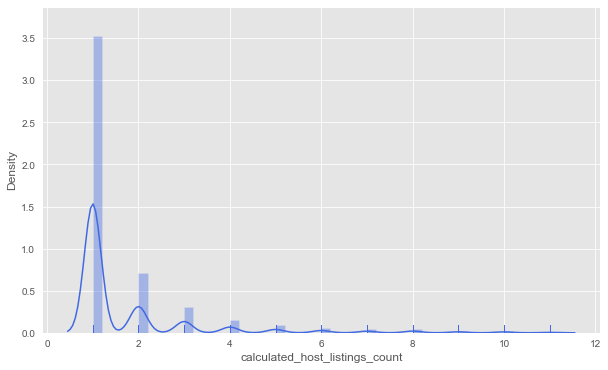

In [48]:
sns.set_style("dark")
plt.style.use("ggplot")
plt.figure(figsize=[10,6])
sns.distplot(airbnb['calculated_host_listings_count'], rug = True, color = 'royalblue')
plt.show()

In [49]:
# Creating calculated_host_listings_count into binned groups and storing it in another column. Keeping the numeric values too for analysis. 

airbnb["calculated_host_listings_range"] = pd.cut(airbnb.calculated_host_listings_count, 
                                                  [0,2,5,10,12], 
                                                  labels=["<2", "2 to 5", "5 to 10", "10+"])
airbnb["calculated_host_listings_range"].value_counts()

<2         37234
2 to 5      4844
5 to 10     1747
10+           87
Name: calculated_host_listings_range, dtype: int64

In [50]:
# Converting calculated_host_listings_range to object datatype

airbnb['calculated_host_listings_range'] = airbnb.calculated_host_listings_range.astype(str)

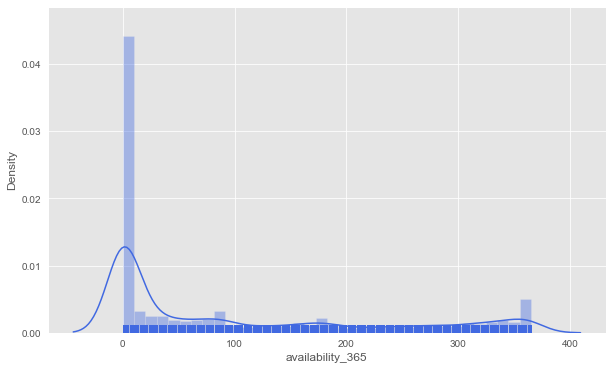

In [51]:
sns.set_style("dark")
plt.style.use("ggplot")
plt.figure(figsize=[10,6])
sns.distplot(airbnb['availability_365'], rug = True, color = 'royalblue')
plt.show()

In [52]:
# Creating availability_365 into binned groups and storing it in another column. Keeping the numeric values too for analysis. 

airbnb["availability_365_range"] = pd.cut(airbnb.availability_365, 
                                                  [0,100,200,300,400], 
                                                  labels=["<100", "100 to 200", "200 to 300", "300+"])
airbnb["availability_365_range"].value_counts()

<100          11556
300+           5921
100 to 200     5170
200 to 300     4116
Name: availability_365_range, dtype: int64

In [53]:
# Converting availability_365_range to object datatype

airbnb['availability_365_range'] = airbnb.availability_365_range.astype(str)

In [54]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43912 entries, 0 to 48894
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              43912 non-null  object 
 1   name                            43897 non-null  object 
 2   host_id                         43912 non-null  object 
 3   host_name                       43892 non-null  object 
 4   neighbourhood_group             43912 non-null  object 
 5   neighbourhood                   43912 non-null  object 
 6   latitude                        43912 non-null  float64
 7   longitude                       43912 non-null  float64
 8   room_type                       43912 non-null  object 
 9   price                           43912 non-null  int64  
 10  minimum_nights                  43912 non-null  int64  
 11  number_of_reviews               43912 non-null  int64  
 12  last_review                     

In [55]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,minimum_nights_range,number_of_reviews_range,reviews_per_month_range,calculated_host_listings_range,availability_365_range
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365,<10,<50,<2,5 to 10,300+
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355,<10,<50,<2,<2,300+
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,0.00,1,365,<10,nan,nan,<2,300+
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0,<10,<50,<2,<2,nan
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,22-06-2019,0.59,1,129,<10,50 to 100,<2,<2,100 to 200


In [56]:
# Converting date to Pandas datetime format

#airbnb['last_review'] = pd.to_datetime(airbnb['last_review'])

In [57]:
# Extracting Year, Month and Day 

#airbnb['year'] = airbnb['last_review'].dt.year
#airbnb['month'] = airbnb['last_review'].dt.month
#airbnb['day'] = airbnb['last_review'].dt.day

airbnb['last_review_year'] = pd.DatetimeIndex(airbnb['last_review']).year
airbnb['last_review_month'] = pd.DatetimeIndex(airbnb['last_review']).month
airbnb['last_review_day'] = pd.DatetimeIndex(airbnb['last_review']).day

In [58]:
# Dropping the original last_review column

airbnb.drop('last_review', axis=1, inplace=True)

In [59]:
# Replacing the remaining missing values with a Not Reviewed option

airbnb['last_review_year'] = airbnb.last_review_year.fillna("Not Reviewed")
airbnb['last_review_month'] = airbnb.last_review_month.fillna("Not Reviewed")
airbnb['last_review_day'] = airbnb.last_review_day.fillna("Not Reviewed")

In [60]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43912 entries, 0 to 48894
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              43912 non-null  object 
 1   name                            43897 non-null  object 
 2   host_id                         43912 non-null  object 
 3   host_name                       43892 non-null  object 
 4   neighbourhood_group             43912 non-null  object 
 5   neighbourhood                   43912 non-null  object 
 6   latitude                        43912 non-null  float64
 7   longitude                       43912 non-null  float64
 8   room_type                       43912 non-null  object 
 9   price                           43912 non-null  int64  
 10  minimum_nights                  43912 non-null  int64  
 11  number_of_reviews               43912 non-null  int64  
 12  reviews_per_month               

In [61]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,minimum_nights_range,number_of_reviews_range,reviews_per_month_range,calculated_host_listings_range,availability_365_range,last_review_year,last_review_month,last_review_day
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365,<10,<50,<2,5 to 10,300+,2018.0,10.0,19.0
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355,<10,<50,<2,<2,300+,2019.0,5.0,21.0
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,0.00,1,365,<10,nan,nan,<2,300+,Not Reviewed,Not Reviewed,Not Reviewed
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0,<10,<50,<2,<2,nan,2018.0,11.0,19.0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129,<10,50 to 100,<2,<2,100 to 200,2019.0,6.0,22.0


In [62]:
airbnb.shape

(43912, 23)

In [63]:
null_values(airbnb)

host_name                         0.05
name                              0.03
id                                0.00
calculated_host_listings_count    0.00
last_review_month                 0.00
last_review_year                  0.00
availability_365_range            0.00
calculated_host_listings_range    0.00
reviews_per_month_range           0.00
number_of_reviews_range           0.00
minimum_nights_range              0.00
availability_365                  0.00
number_of_reviews                 0.00
reviews_per_month                 0.00
minimum_nights                    0.00
price                             0.00
room_type                         0.00
longitude                         0.00
latitude                          0.00
neighbourhood                     0.00
neighbourhood_group               0.00
host_id                           0.00
last_review_day                   0.00
dtype: float64

In [64]:
# Extracting the modified version for Tableau demonstartion 

#airbnb.to_csv('AB_NYC_2019(Modified).csv',index=False)


# <font color = blue> Exploratory Data Analysis </font>


### Univariate General Analysis: 

In [65]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,minimum_nights_range,number_of_reviews_range,reviews_per_month_range,calculated_host_listings_range,availability_365_range,last_review_year,last_review_month,last_review_day
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365,<10,<50,<2,5 to 10,300+,2018.0,10.0,19.0
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355,<10,<50,<2,<2,300+,2019.0,5.0,21.0
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,0.00,1,365,<10,nan,nan,<2,300+,Not Reviewed,Not Reviewed,Not Reviewed
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0,<10,<50,<2,<2,nan,2018.0,11.0,19.0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129,<10,50 to 100,<2,<2,100 to 200,2019.0,6.0,22.0


In [66]:
# Extracting and Tagging the Numeric Columns: 

int_cols = airbnb.select_dtypes(include=['int64', 'float64']).columns
list(enumerate(int_cols))

[(0, 'latitude'),
 (1, 'longitude'),
 (2, 'price'),
 (3, 'minimum_nights'),
 (4, 'number_of_reviews'),
 (5, 'reviews_per_month'),
 (6, 'calculated_host_listings_count'),
 (7, 'availability_365')]

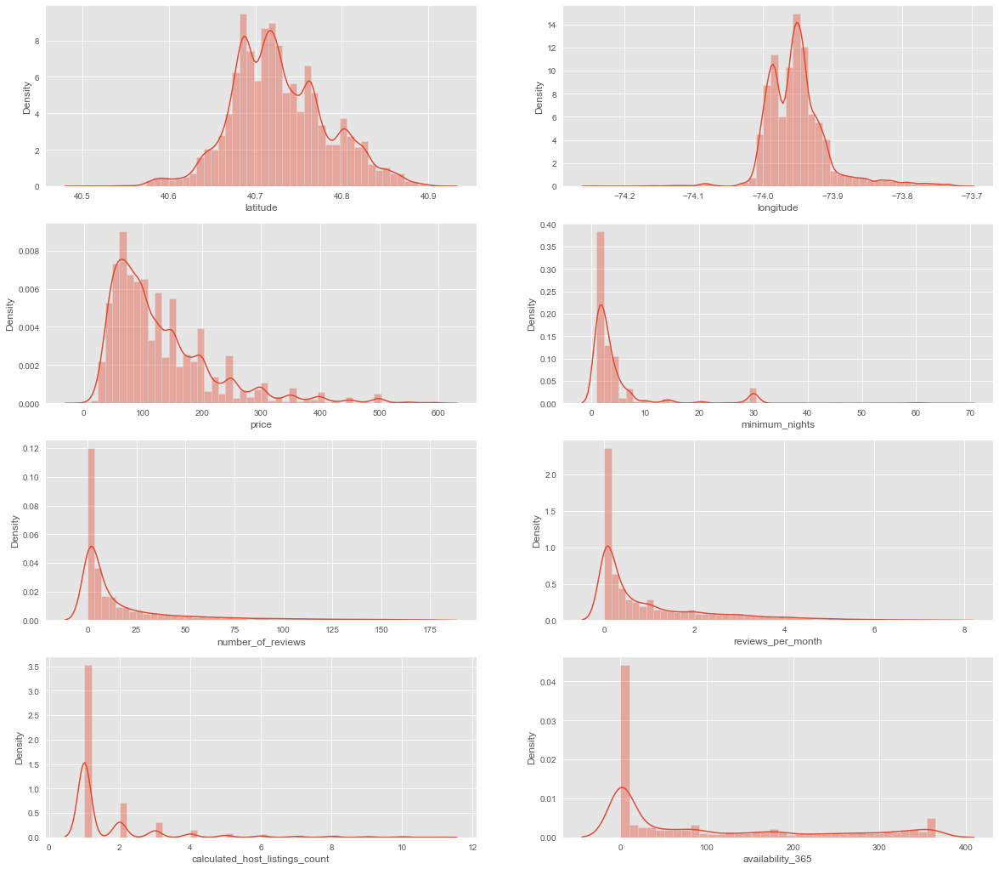

In [67]:
# Plotting the Numric Variables Distribution: 

int_cols = airbnb.select_dtypes(include=['int64', 'float64']).columns
plt.figure(figsize=[20,18])

for n,col in enumerate(int_cols):
    plt.subplot(4,2,n+1)
    sns.distplot(airbnb[col])

### <font color = Green > Insights: </font>

+ The Highest price range seems to be between 30 dollars till 150 dollars per day stay for most of the sites hosted. 
+ Still we can see there are many sites which cost more than 200 dollars per day stay and even going upto 500 dollars. 

In [68]:
# Univatriate Categorical Analysis for better understanding of those columns:

cat_cols = airbnb.select_dtypes(include=['object']).columns
cat_cols

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'room_type', 'minimum_nights_range',
       'number_of_reviews_range', 'reviews_per_month_range',
       'calculated_host_listings_range', 'availability_365_range',
       'last_review_year', 'last_review_month', 'last_review_day'],
      dtype='object')

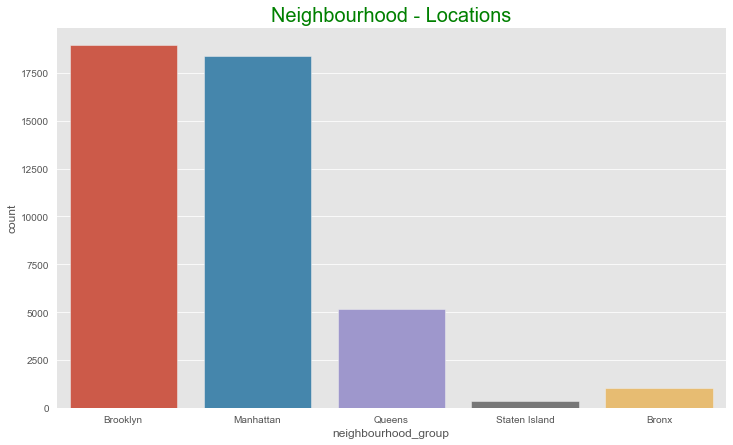

In [69]:
# Checking the count of sites Location 

plt.figure(figsize=[12,7])
sns.countplot(airbnb.neighbourhood_group)
plt.title('Neighbourhood - Locations', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

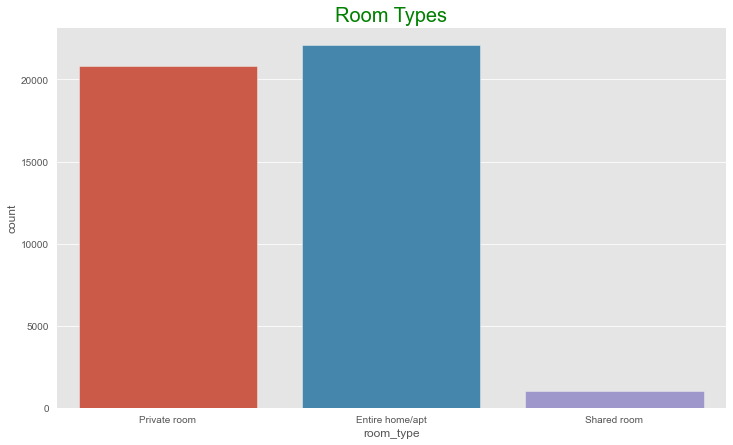

In [70]:
# Checking the count of Room Types

plt.figure(figsize=[12,7])
sns.countplot(airbnb.room_type)
plt.title('Room Types', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

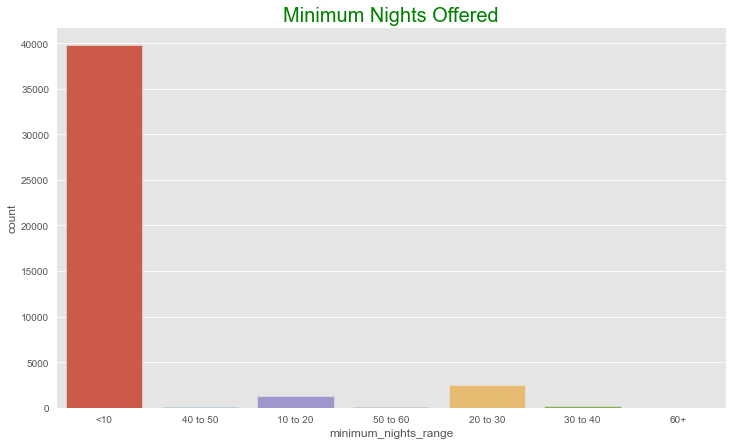

In [71]:
# Checking the count of Minimum Nights Offered 

plt.figure(figsize=[12,7])
sns.countplot(airbnb.minimum_nights_range)
plt.title('Minimum Nights Offered', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

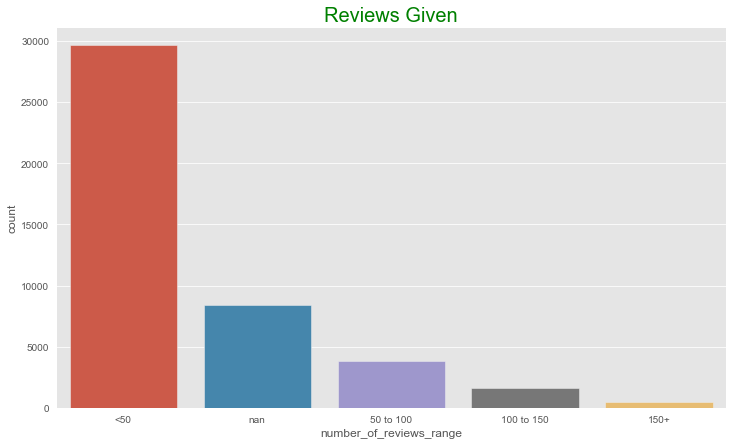

In [72]:
# Checking the count of Reviews Given

plt.figure(figsize=[12,7])
sns.countplot(airbnb.number_of_reviews_range)
plt.title('Reviews Given', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

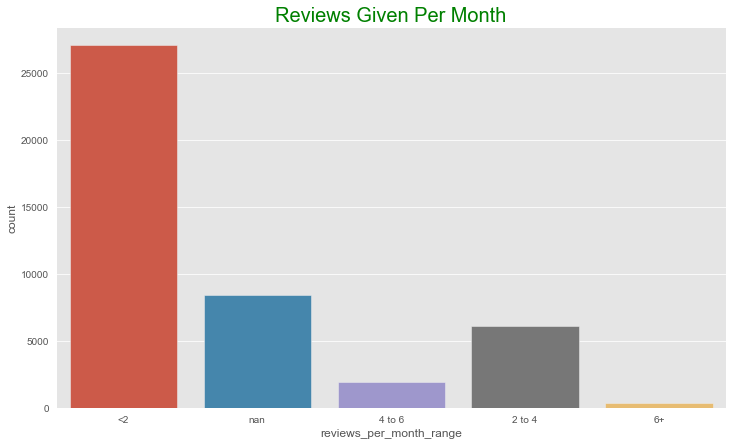

In [73]:
# Checking the count of Reviews Given Per Month

plt.figure(figsize=[12,7])
sns.countplot(airbnb.reviews_per_month_range)
plt.title('Reviews Given Per Month', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

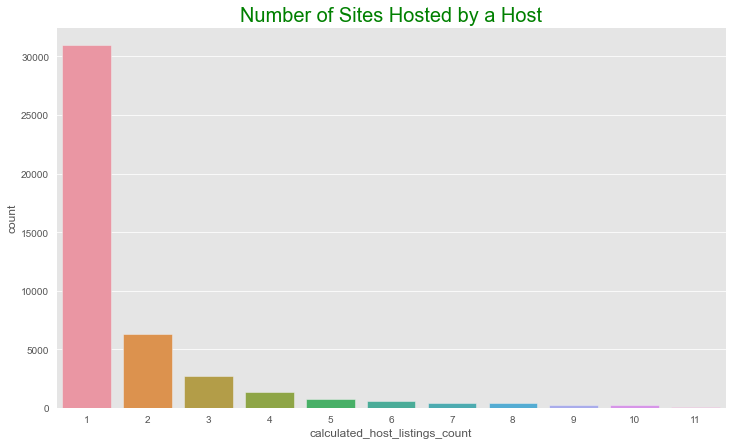

In [74]:
# Checking the count of Number of Sites Hosted by a Host 

plt.figure(figsize=[12,7])
sns.countplot(airbnb.calculated_host_listings_count)
plt.title('Number of Sites Hosted by a Host', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

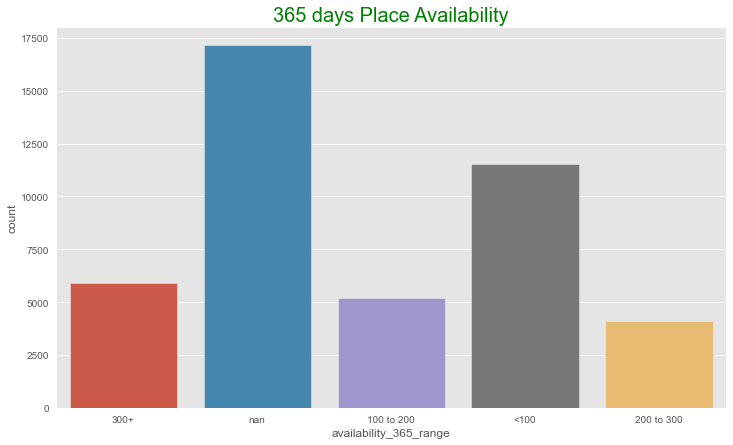

In [75]:
# Checking the count of 365 days Place Availability  

plt.figure(figsize=[12,7])
sns.countplot(airbnb.availability_365_range)
plt.title('365 days Place Availability', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

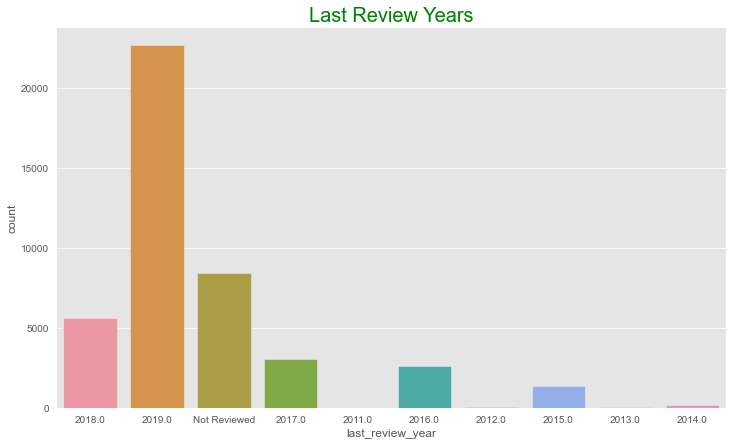

In [76]:
# Checking the count of Last Review Years 

plt.figure(figsize=[12,7])
sns.countplot(airbnb.last_review_year)
plt.title('Last Review Years', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

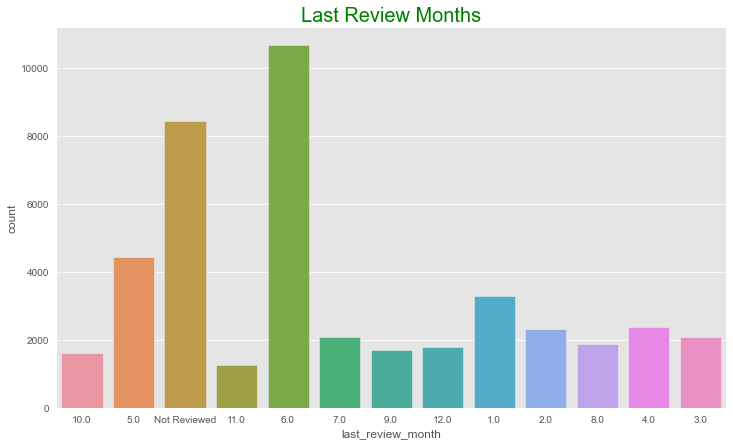

In [77]:
# Checking the count of Last Review Months

plt.figure(figsize=[12,7])
sns.countplot(airbnb.last_review_month)
plt.title('Last Review Months', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.show()

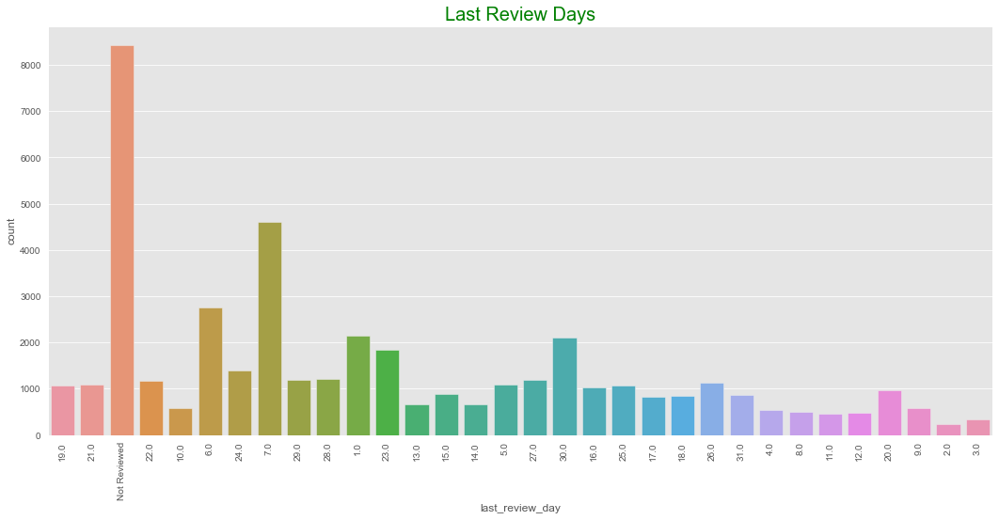

In [78]:
# Checking the count of Last Review Days

plt.figure(figsize=[18,8])
sns.countplot(airbnb.last_review_day)
plt.title('Last Review Days', fontdict={'fontsize': 20, 'fontweight': 5, 'color': 'Green'})
plt.xticks(rotation=90)
plt.show()

### <font color = Green > Insights: </font>


+ Most of the times last reviews were not provided when we see Day wise. Next, majority of times it was provided on the 6th and 7th day of the month followed by 1st and last day of the month.
+ 6th month of the year i.e June seems to recieve most of the last reviews in all years followed by 5th month. 
+ Intial years which were 2011 till 2014, last reviews were negligible. After that it slowing going up and most of the last reviews are receved in the recent years of the data that is 2019 and 2018. 
+ Most of the sites hosted have less than 100 days availabilty in compare to all 365 days. Also, moajority of them have prvided 0 days availabilty which has to be cross checked by the Hosting Acquisition and Operations teams to know the reason. 
+ Majority of the Host have less than 2 sites hosted by them on the platform. 
+ Most the sites have receievd less than 2 reviews per month which indicates bad customer experience offered by majority sites. 
+ Also, Majority of the sites have received less than 50 reviews till date which is kind of less as per social norms. 
+ Majority of the sites provide less than 10 nights stay at a time. 
+ Majority of the sites hosted are either Private rooms or Entire apartment but very less Shared rooms. 
+ Broklyn and Manhatten are dominating when it comes to listed hostings followed by Queens. 

### Bivariate and Multivariate Analysis:

In [79]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,minimum_nights_range,number_of_reviews_range,reviews_per_month_range,calculated_host_listings_range,availability_365_range,last_review_year,last_review_month,last_review_day
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365,<10,<50,<2,5 to 10,300+,2018.0,10.0,19.0
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355,<10,<50,<2,<2,300+,2019.0,5.0,21.0
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,0.00,1,365,<10,nan,nan,<2,300+,Not Reviewed,Not Reviewed,Not Reviewed
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0,<10,<50,<2,<2,nan,2018.0,11.0,19.0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129,<10,50 to 100,<2,<2,100 to 200,2019.0,6.0,22.0


In [107]:
# Majority of the matches palyed in which city and in which year?
#import plotly
#import plotly.express as px

#result = airbnb.groupby('price').mean()

#plot = px.treemap(airbnb, values = 'price', path=['neighbourhood_group', 'neighbourhood'], color = "price",
#                 color_discrete_sequence = px.colors.qualitative.Dark24,
#                 title = 'Location vs Price')
#plot.update_layout(margin = dict(t=50, l=25, r=25, b=25))
#plot.show()

In [80]:
int_cols = airbnb.select_dtypes(include=['int64', 'float64']).columns
int_cols

Index(['latitude', 'longitude', 'price', 'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

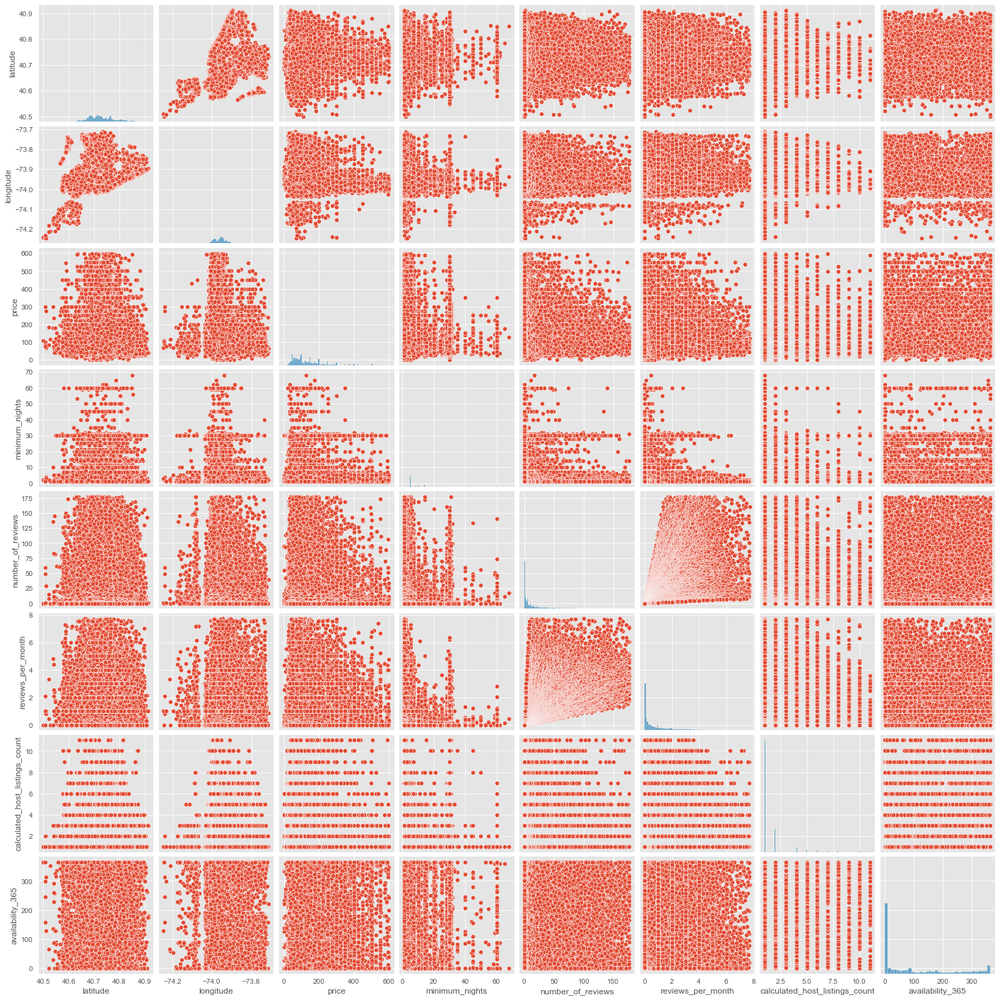

In [83]:
# Plotting the pairplot

sns.pairplot(airbnb)
plt.show()